In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import glob

from camera_calibration import CameraCalibrator, plot_single_camera_image_using_calibrator
from lane_detection import LaneDetectionPipeline
from image_utils import *
from perspective_transform import BirdsEyeViewTransform
from lane_finding_histogram import *


Camera Calibration:
-------------------
Description

In [2]:
calibrator = CameraCalibrator()
calibrator.restore('models/camera_calibration_model')

calibration model restored from models/camera_calibration_model


#### Here are some of the results of applying distortion correction chessboard images:

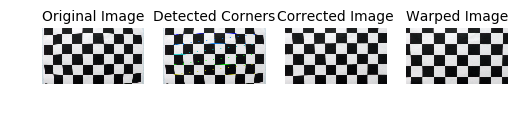

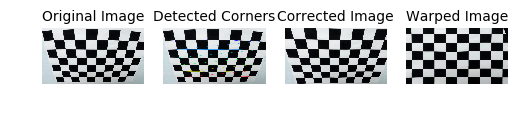

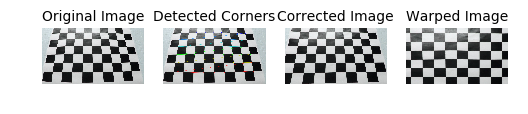

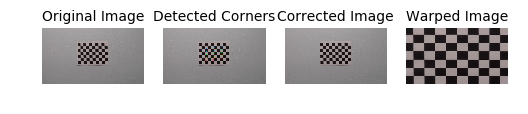

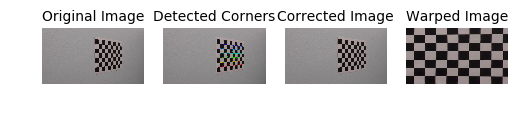

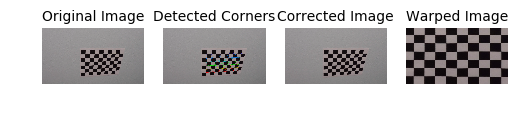

In [3]:
sample_camera_images_and_corners = [
        (cv2.imread('camera_cal/calibration1.jpg'), 9, 5),
        (cv2.imread('camera_cal/calibration2.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration3.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration6.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration8.jpg'), 9, 6),
        (cv2.imread('camera_cal/calibration10.jpg'), 9, 6)]

for img, nx, ny in sample_camera_images_and_corners:
    plot_single_camera_image_using_calibrator(img, nx, ny, calibrator)
    plt.show()

#### Here are results of applying distortion correction on test road images:

In [4]:
## helper to display image grid
def grid_plot(image_cols):
    ncols = len(image_cols)
    nrows = len(image_cols[0][1])
    fig, axes = plt.subplots(nrows, ncols, figsize = (8*ncols, 4*nrows))
    fig.tight_layout()
    fig.subplots_adjust(wspace = 0.1, hspace=0.1, )

    for r, ax in enumerate(axes):
        for c, (colname, imgs) in enumerate(image_cols):
            img = imgs[r]
            cmap = plt.cm.gray if img.ndim < 3 else None
            ax[c].imshow(img, cmap=cmap)
            ax[c].set_axis_off()
            ax[c].set_title(colname)

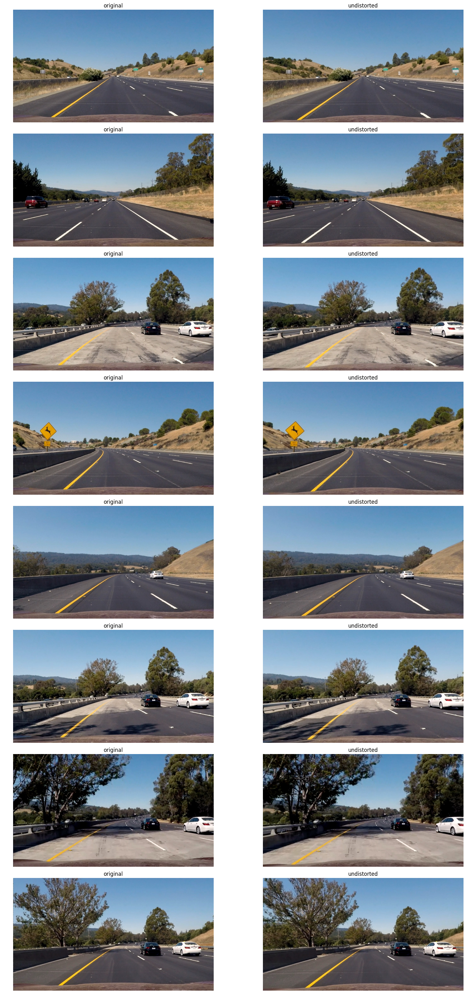

In [5]:
test_img_files = glob.glob("test_images/*.jpg")
test_images = [read_image_as_rgb(f) for f in test_img_files]
undist_images = [calibrator.undistort(img) for img in test_images]
grid_plot( [("original", test_images), 
           ("undistorted", undist_images)])

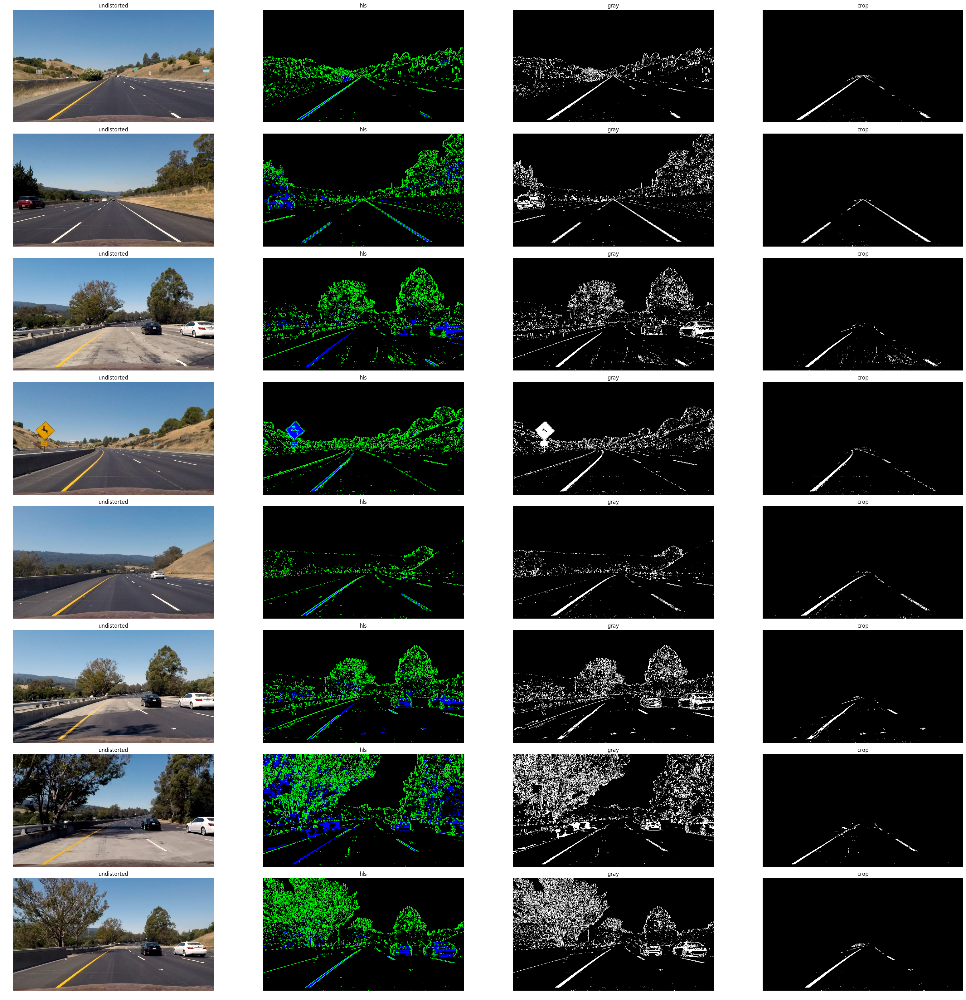

In [6]:
hls_transforms = [get_hls_transform_image(img, kernel_size =9) for img in undist_images]
custom_gray_transforms = [custom_gray_transform(img) for img in undist_images]
crops = [trapezoidal_crop(img) for img in custom_gray_transforms]
grid_plot([("undistorted", undist_images), 
            ("hls", hls_transforms),
            ("gray", custom_gray_transforms),
            ('crop', crops)
           ])

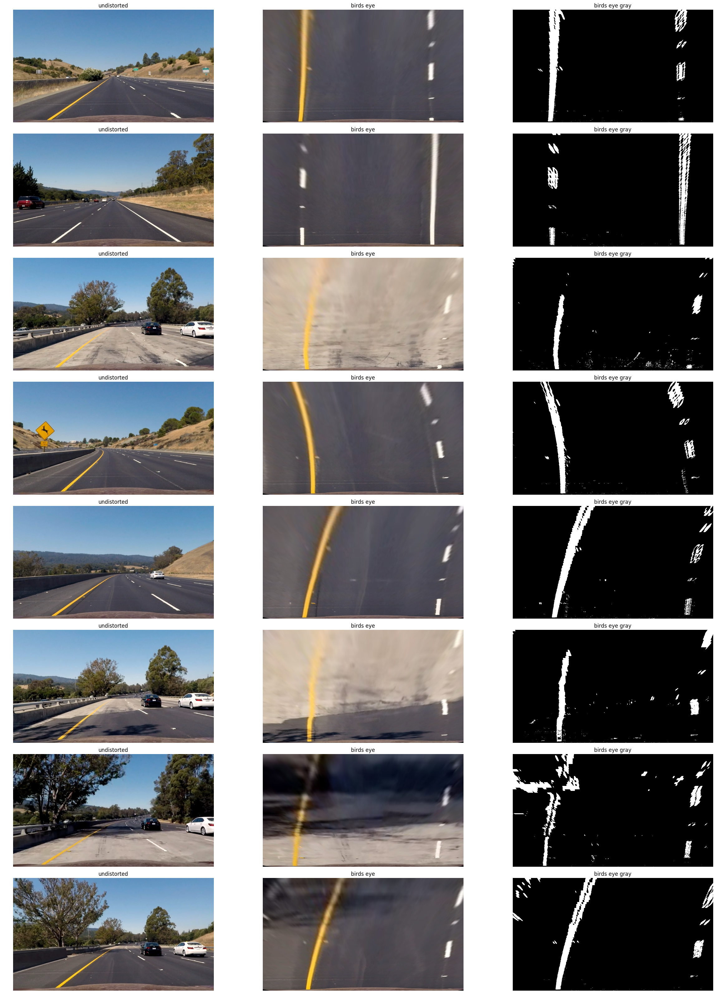

In [7]:
perspective_transformer = BirdsEyeViewTransform()

birds_eye_orig = [perspective_transformer.get_birds_eye_view(img) for img in undist_images]
birds_eye_gray = [perspective_transformer.get_birds_eye_view(img) for img in crops]

birds_eye_crops = [perspective_transformer.get_birds_eye_view(img) for img in crops]
grid_plot([("undistorted", undist_images), 
            ("birds eye", birds_eye_orig),
            ("birds eye gray", birds_eye_gray)
           ])

/code/carnd/Advanced-Lane-Detection/lane_finding_histogram.py:10: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  histogram = np.sum(binary_warped_img[binary_warped_img.shape[0] / 2:, :], axis=0)


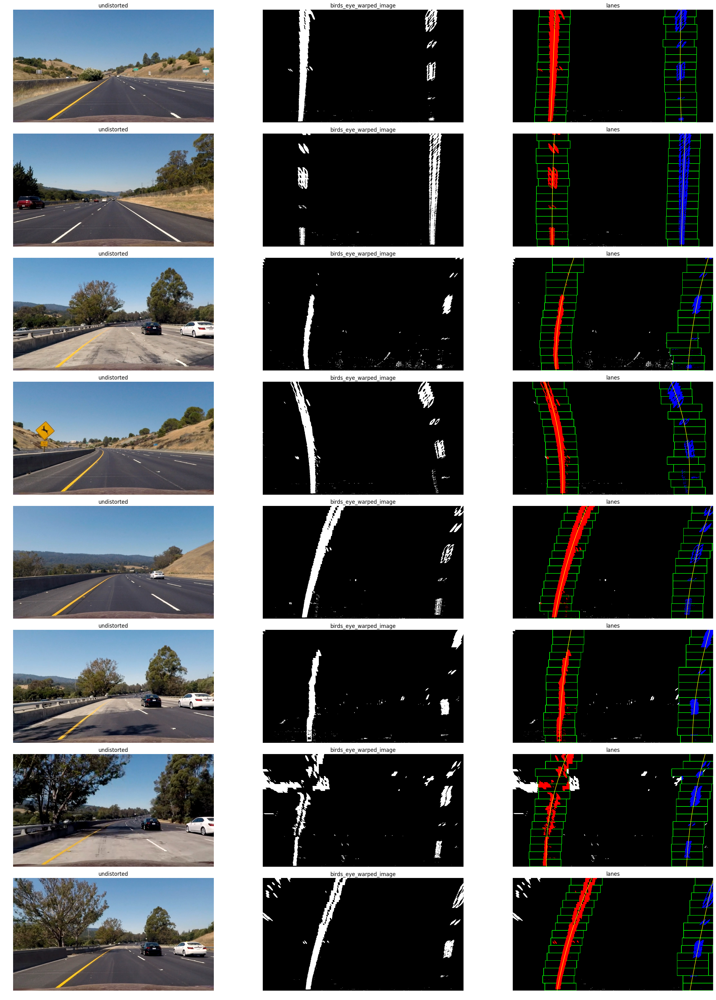

In [9]:
nrows = len(birds_eye_crops)
ncols = 3
fig, ax = plt.subplots(nrows, ncols, figsize = (8*ncols, 4*nrows))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for idx, binary_warped in enumerate(birds_eye_crops):
    ax[idx][0].imshow(undist_images[idx], cmap='gray') 
    ax[idx][0].axis("off")
    ax[idx][0].set_title("undistorted")

    ax[idx][1].imshow(binary_warped, cmap='gray') 
    ax[idx][1].axis("off")
    ax[idx][1].set_title("birds_eye_warped_image")

    plot_left_and_right_lanes(binary_warped, 15, ax[idx][2])
    ax[idx][2].axis("off")
    ax[idx][2].set_title("lanes")